In [85]:
import numpy as np
import pandas as pd
import tensorflow as tf
from matplotlib import pyplot as plt
import cv2
%matplotlib inline

In [86]:
import warnings
warnings.filterwarnings('ignore')

# Import the Fashion MNIST dataset

In [87]:
fashion_mnist = tf.keras.datasets.fashion_mnist

(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()

In [88]:
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat','Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']

# Explore the data

In [89]:
x_train.shape, y_train.shape

((60000, 28, 28), (60000,))

In [90]:
x_test.shape, y_test.shape

((10000, 28, 28), (10000,))

In [91]:
np.unique(y_train), np.unique(y_test)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8),
 array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8))

In [92]:
# importing the collections module
import collections
# intializing the arr
arr = list(y_train)
# getting the elements frequencies using Counter class
elements_count = collections.Counter(arr)
# printing the element and the frequency
for key, value in elements_count.items():
   print(f"{key}: {value}")

9: 6000
0: 6000
3: 6000
2: 6000
7: 6000
5: 6000
1: 6000
6: 6000
4: 6000
8: 6000


# Preprocess the data

In [93]:
def plot_image(index):
    plt.figure()
    plt.imshow(x_train[index])
    plt.colorbar()
    plt.grid(False)
    plt.xlabel(class_names[y_train[index]])

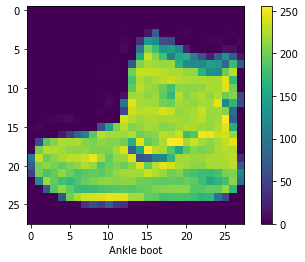

In [94]:
plot_image(0)

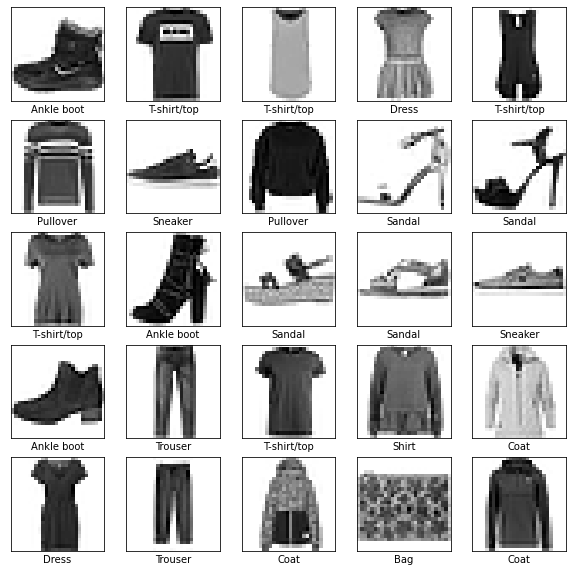

In [95]:
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(x_train[i], cmap=plt.cm.binary)
    plt.xlabel(class_names[y_train[i]])
plt.show()

In [96]:
x_train_784 = x_train.reshape(60000,784)
x_test_784 = x_test.reshape(10000,784)

In [97]:
x_train_784.shape, x_test_784.shape

((60000, 784), (10000, 784))

# Normalize the data

In [98]:
# from sklearn.preprocessing import StandardScaler
# scaler = StandardScaler()
# scaler.fit(x_train_784)

In [99]:
x_train_scal = x_train_784 / 255
x_test_scal = x_test_784 / 255

In [100]:
x_train_scal.shape, x_test_scal.shape

((60000, 784), (10000, 784))

In [101]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

In [102]:
pca.fit(x_train_scal)
print(pca.n_components_)

2


In [103]:
x_train_pca_visaulize = pca.transform(x_train_scal)

In [104]:
x_train_pca_visaulize.shape

(60000, 2)

# Apply the Kmeans on 2 Feature

In [105]:
import time
from sklearn.cluster import KMeans
start_time = time.time()
#np.random.seed(0)
kmeans_visual = KMeans(n_clusters=10)  
# Maximum number of iterations of the k-means algorithm for a single run. n_init : int, default: 10. Number of time the k-means algorithm will be run with different centroid seeds.
label = kmeans_visual.fit_predict(x_train_pca_visaulize)
print("using kmeans clustering with 2 features took %s seconds" % (time.time() - start_time))

using kmeans clustering with 2 features took 2.206204652786255 seconds


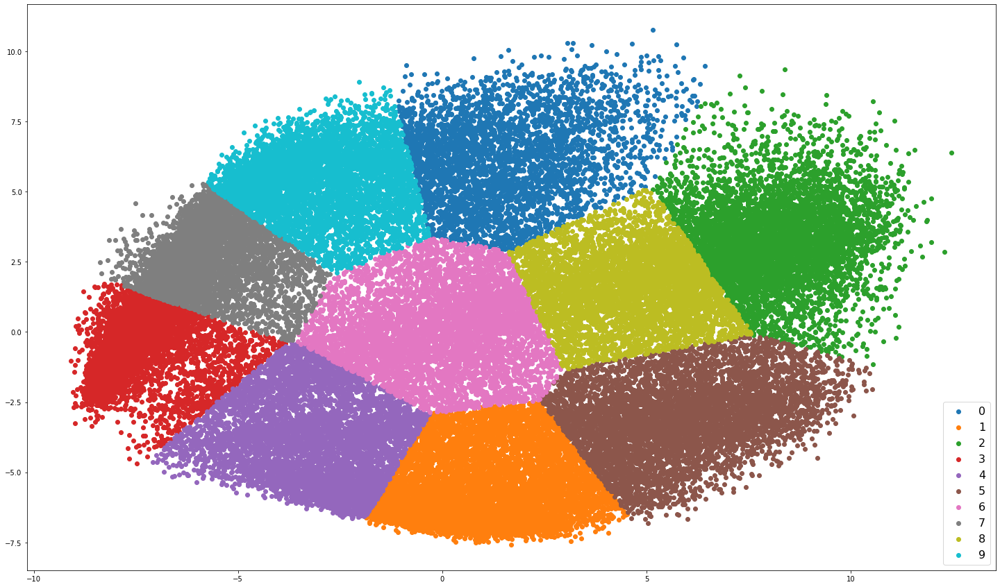

In [106]:
#Getting unique labels
 
u_labels = np.unique(label)
 
#plotting the results:
 
f = plt.figure()
f.set_figwidth(25)
f.set_figheight(15)
for i in u_labels:
    plt.scatter(x_train_pca_visaulize[label == i , 0] , x_train_pca_visaulize[label == i , 1] , label = i)
plt.legend(fontsize=16, loc='lower right')
plt.show()

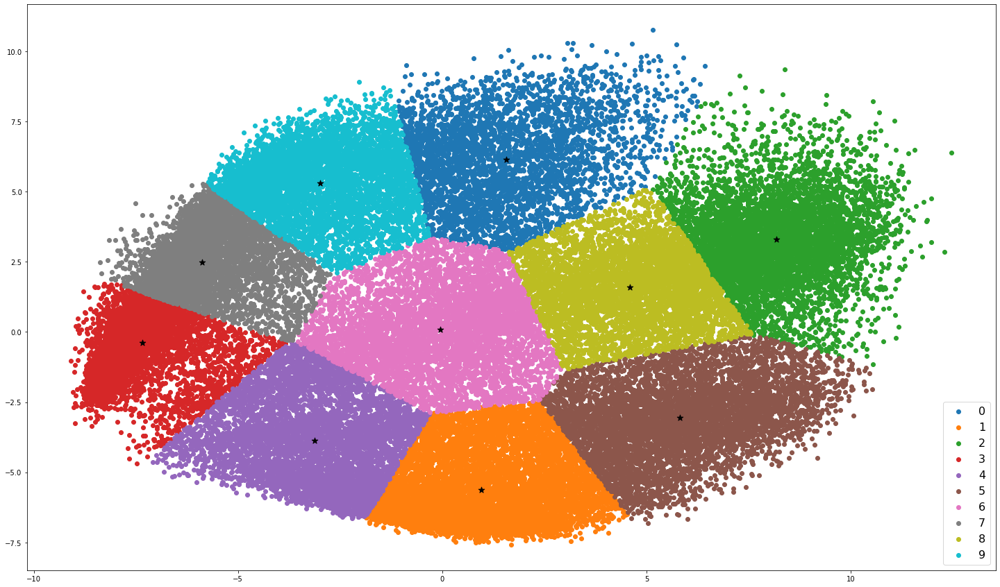

In [107]:
#Getting the Centroids
centroids = kmeans_visual.cluster_centers_
u_labels = np.unique(label)
  
#plotting the results:
f = plt.figure()
f.set_figwidth(25)
f.set_figheight(15)
 
for i in u_labels:
    plt.scatter(x_train_pca_visaulize[label == i , 0] , x_train_pca_visaulize[label == i , 1] , label = i)
plt.scatter(centroids[:,0] , centroids[:,1] , s = 80,marker='*' ,color='k')
plt.legend(fontsize=16, loc='lower right')
plt.show()

In [108]:
from sklearn.decomposition import PCA
pca= PCA(.98)

In [109]:
pca.fit(x_train_scal)
print(pca.n_components_)

349


In [110]:
x_train_scal_pca = pca.transform(x_train_scal)
x_test_scal_pca = pca.transform(x_test_scal)

In [111]:
x_train_scal_pca.shape, x_test_scal_pca.shape

((60000, 349), (10000, 349))

In [112]:
inverse = pca.inverse_transform(x_train_scal_pca)

In [113]:
inverse.shape

(60000, 784)

Text(0.5, 1.0, 'Inversed Image')

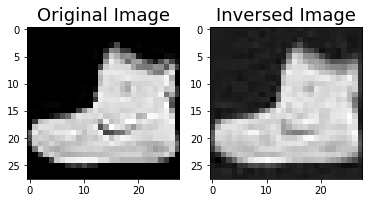

In [114]:
plt.subplot(1,2,1)
#reshaping from 1D to 2D array (28 * 28 pixels) which can be plotted 
plt.imshow(x_train_scal[0].reshape(28, 28), cmap= plt.cm.gray)
plt.title('Original Image', fontsize = 18)
plt.subplot(1,2,2)
plt.imshow(inverse[0].reshape(28,28),cmap= plt.cm.gray)
plt.title('Inversed Image', fontsize = 18)

In [115]:
#using kmeans clustering with 420 features
import time
from sklearn.cluster import KMeans
start_time = time.time()
#np.random.seed(0)
kmeans_pca = KMeans(n_clusters=10)  
# Maximum number of iterations of the k-means algorithm for a single run. n_init : int, default: 10. Number of time the k-means algorithm will be run with different centroid seeds.
kmeans_pca.fit(x_train_scal_pca)
print("using kmeans clustering with 420 features took %s seconds" % (time.time() - start_time))

using kmeans clustering with 420 features took 10.410517692565918 seconds


In [117]:
#using kmeans clustering with 784 features
start_time = time.time()
# kmeans_actual = KMeans (init = "k-means++", n_clusters=10, n_init=35)
kmeans_actual = KMeans (n_clusters=10)
kmeans_actual.fit(x_train_scal)
print("using kmeans clustering with 784 features took %s seconds" % (time.time() - start_time))

using kmeans clustering with 784 features took 21.948641538619995 seconds


In [118]:
y_predicted_pca = kmeans_pca.predict(x_train_scal_pca)
print(y_predicted_pca)
print(len(y_predicted_pca))
print("The labels of the clusters (with pca) are " + str(np.unique(y_predicted_pca)))

[6 0 2 ... 0 2 2]
60000
The labels of the clusters (with pca) are [0 1 2 3 4 5 6 7 8 9]


In [119]:
y_predicted_actual =kmeans_actual.predict(x_train_scal)
print(y_predicted_actual)
print(len(y_predicted_actual))
print("The labels of the clusters (with pca) are " + str(np.unique(y_predicted_actual)))

[1 6 5 ... 6 5 5]
60000
The labels of the clusters (with pca) are [0 1 2 3 4 5 6 7 8 9]


In [120]:
#defining actual number of labels of train dataset
label_column = y_train
print(label_column.shape)
labels = len(np.unique(label_column))
print(labels)
class_label = {0:'T-shirt/top', 1:'Trouser',2: 'Pullover',3: 'Dress',4: 'Coat',5:'Sandal',6: 'Shirt', 7:'Sneaker',8:  'Bag',9: 'Ankle boot'}

(60000,)
10


In [121]:
num_cluster_labels_pca = len(np.unique(y_predicted_pca))
#assigning indexes into respective cluster members
cluster_indexes_pca = [[] for i in range(num_cluster_labels_pca)]

In [122]:
#print(cluster_indexes)
for i,label in enumerate(y_predicted_pca):
    for n in range(num_cluster_labels_pca):
        if label == n:
            cluster_indexes_pca[n].append(i)
        else:
            continue

In [123]:
#number of datapoints in individual clusters
print('With PCA')
for i in range(num_cluster_labels_pca):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_pca[i])))

With PCA
No. of items in Cluster 0: 7373
No. of items in Cluster 1: 7381
No. of items in Cluster 2: 7816
No. of items in Cluster 3: 6573
No. of items in Cluster 4: 9552
No. of items in Cluster 5: 2368
No. of items in Cluster 6: 2990
No. of items in Cluster 7: 2570
No. of items in Cluster 8: 4268
No. of items in Cluster 9: 9109


In [124]:
num_cluster_labels_actual = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [125]:
#print(cluster_indexes)
for i,label in enumerate(y_predicted_actual):
    for n in range(num_cluster_labels_actual):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [126]:
#number of datapoints in individual clusters
print('Without PCA')
s=0
for i in range(num_cluster_labels_actual):
    s = s + len(cluster_indexes_actual[i]) 
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 2571
No. of items in Cluster 1: 2904
No. of items in Cluster 2: 7436
No. of items in Cluster 3: 9605
No. of items in Cluster 4: 4294
No. of items in Cluster 5: 7770
No. of items in Cluster 6: 7379
No. of items in Cluster 7: 9089
No. of items in Cluster 8: 2362
No. of items in Cluster 9: 6590


In [127]:
import plotly.graph_objs as go
# import plotly.express as px
from plotly.offline import iplot
# plt.rcParams["figure.figsize"] = (20,25)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_pca[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_train_scal_pca[my_members,0],
        y=x_train_scal_pca[my_members,1],
        z=x_train_scal_pca[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster) # + ' Item: ' + data_info 
    )
    layout = go.Layout(title = '3D Scatter plot with 420 Principal Components')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [128]:
#3D plot with two principal components
#two principal components from 784 features
pca = PCA(n_components=3)
x_train_pca_visualize = pca.fit_transform(x_train_scal)
x_train_pca_visualize.shape

(60000, 3)

In [129]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_train_pca_visualize[my_members,0],
        y=x_train_pca_visualize[my_members,1],
        z=x_train_pca_visualize[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [130]:
#assigning actual label values(from train dataset) along side the indices of items of each cluster
y_cluster_len_pca = len(np.unique(y_test))
y_train_value_pca = [ [] for i in range(y_cluster_len_pca)]

In [131]:
for i in range(y_cluster_len_pca):
    y_train_value_pca[i]= y_train[cluster_indexes_pca[i]]

In [132]:
for index, label in enumerate(y_train_value_pca):
    print('Index='+ str(index))
    print('Label=' + str(label))
    print('Length='+ str(len(label)))
    print('')

Index=0
Label=[0 0 0 ... 0 6 3]
Length=7373

Index=1
Label=[3 4 4 ... 4 4 2]
Length=7381

Index=2
Label=[0 5 5 ... 5 0 5]
Length=7816

Index=3
Label=[7 5 5 ... 5 5 7]
Length=6573

Index=4
Label=[2 2 6 ... 4 4 6]
Length=9552

Index=5
Label=[8 8 8 ... 8 8 8]
Length=2368

Index=6
Label=[9 9 9 ... 9 9 9]
Length=2990

Index=7
Label=[8 8 4 ... 8 2 8]
Length=2570

Index=8
Label=[9 9 9 ... 9 7 7]
Length=4268

Index=9
Label=[0 1 1 ... 1 1 1]
Length=9109



In [133]:
#assigning actual label values(from train dataset) along side the indices of items of each cluster
y_cluster_len_actual = len(np.unique(y_test))
y_train_value_actual = [ [] for i in range(y_cluster_len_actual)]

In [134]:
for i in range(y_cluster_len_actual):
    y_train_value_actual[i]= y_train[cluster_indexes_actual[i]] 

In [135]:
for index, label in enumerate(y_train_value_actual):
    print('Index='+ str(index))
    print('Label=' + str(label))
    print('Length='+ str(len(label)))
    print('')

Index=0
Label=[8 8 4 ... 8 2 8]
Length=2571

Index=1
Label=[9 9 9 ... 9 9 9]
Length=2904

Index=2
Label=[3 4 4 ... 4 4 2]
Length=7436

Index=3
Label=[2 2 6 ... 4 4 6]
Length=9605

Index=4
Label=[9 9 9 ... 9 7 7]
Length=4294

Index=5
Label=[0 5 5 ... 5 0 5]
Length=7770

Index=6
Label=[0 0 0 ... 0 6 3]
Length=7379

Index=7
Label=[0 1 1 ... 1 1 1]
Length=9089

Index=8
Label=[8 8 8 ... 8 8 8]
Length=2362

Index=9
Label=[7 5 5 ... 5 5 7]
Length=6590



In [136]:
y_label_count_pca = [ [] for i in range(len(np.unique(y_train)))]

In [137]:
for index,label in enumerate(y_train_value_pca):
  unique, count = np.unique(label,return_counts=True)
  y_label_count_pca[index] = dict(zip(unique,count))

In [138]:
for i in range(10):
  print(f'Cluster : {i} : {y_label_count_pca[i]}')

Cluster : 0 : {0: 3402, 1: 233, 2: 114, 3: 1678, 4: 869, 5: 2, 6: 1051, 8: 22, 9: 2}
Cluster : 1 : {0: 1555, 1: 128, 2: 1794, 3: 495, 4: 1089, 5: 29, 6: 2065, 8: 189, 9: 37}
Cluster : 2 : {0: 622, 1: 158, 2: 532, 3: 543, 4: 258, 5: 3733, 6: 796, 7: 494, 8: 510, 9: 170}
Cluster : 3 : {0: 2, 2: 1, 5: 1471, 6: 7, 7: 4688, 8: 240, 9: 164}
Cluster : 4 : {0: 164, 1: 63, 2: 3497, 3: 49, 4: 3578, 6: 1935, 8: 265, 9: 1}
Cluster : 5 : {0: 23, 1: 3, 2: 27, 3: 5, 4: 16, 5: 4, 6: 63, 7: 1, 8: 2222, 9: 4}
Cluster : 6 : {5: 262, 6: 1, 7: 26, 8: 6, 9: 2695}
Cluster : 7 : {0: 28, 2: 26, 3: 7, 4: 29, 5: 13, 6: 17, 8: 2450}
Cluster : 8 : {5: 485, 7: 791, 8: 68, 9: 2924}
Cluster : 9 : {0: 204, 1: 5415, 2: 9, 3: 3223, 4: 161, 5: 1, 6: 65, 8: 28, 9: 3}


In [139]:
y_label_count_actual = [ [] for i in range(len(np.unique(y_train)))]

In [140]:
for index,label in enumerate(y_train_value_actual):
  unique, count = np.unique(label,return_counts=True)
  y_label_count_actual[index] = dict(zip(unique,count))

In [141]:
for i in range(10):
  print(f'Cluster : {i} : {y_label_count_actual[i]}')

Cluster : 0 : {0: 28, 2: 27, 3: 7, 4: 30, 5: 13, 6: 17, 8: 2449}
Cluster : 1 : {2: 1, 5: 258, 6: 1, 7: 22, 8: 6, 9: 2616}
Cluster : 2 : {0: 1576, 1: 130, 2: 1789, 3: 520, 4: 1080, 5: 29, 6: 2070, 8: 209, 9: 33}
Cluster : 3 : {0: 166, 1: 63, 2: 3515, 3: 49, 4: 3595, 6: 1948, 8: 268, 9: 1}
Cluster : 4 : {5: 475, 7: 764, 8: 61, 9: 2994}
Cluster : 5 : {0: 600, 1: 157, 2: 517, 3: 525, 4: 254, 5: 3763, 6: 779, 7: 505, 8: 499, 9: 171}
Cluster : 6 : {0: 3403, 1: 233, 2: 114, 3: 1679, 4: 870, 5: 2, 6: 1054, 8: 22, 9: 2}
Cluster : 7 : {0: 202, 1: 5414, 2: 9, 3: 3215, 4: 156, 5: 1, 6: 62, 8: 28, 9: 2}
Cluster : 8 : {0: 23, 1: 3, 2: 27, 3: 5, 4: 15, 5: 4, 6: 62, 7: 1, 8: 2218, 9: 4}
Cluster : 9 : {0: 2, 2: 1, 5: 1455, 6: 7, 7: 4708, 8: 240, 9: 177}


Cluster visualization with PCA


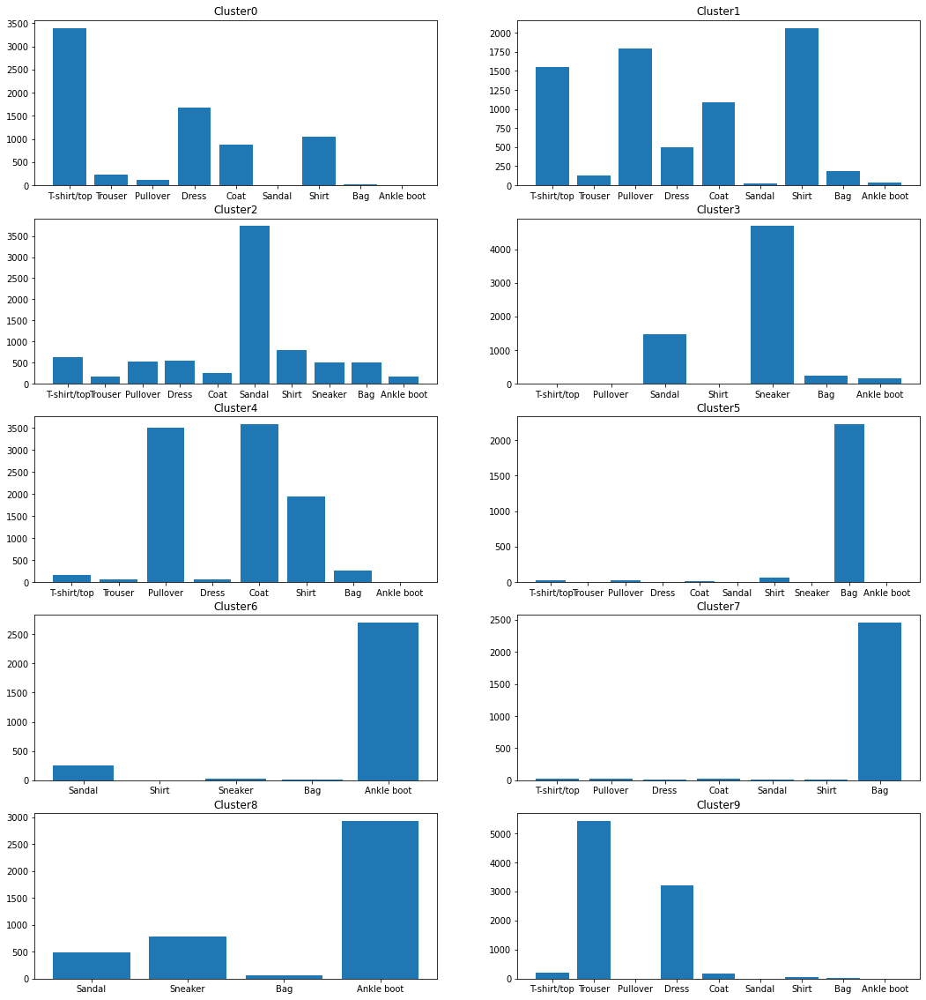

In [142]:
#Visualization of cluster points using barplots
print('Cluster visualization with PCA')
plt.figure(figsize=(18,20))
for i in range(1,11):
    plt.subplot(5,2,i)
    label_count_=y_label_count_pca[i-1]
    plt.bar(range(len(label_count_)),list(label_count_.values()),align='center')
    plt.title('Cluster' + str(i-1))
    a=[]
    for key,value in label_count_.items():
        for key1, value1 in class_label.items():
            if key1 == key:
                a.append(value1)
                break
    plt.xticks(range(len(a)),a)  

Cluster Visualization without PCA


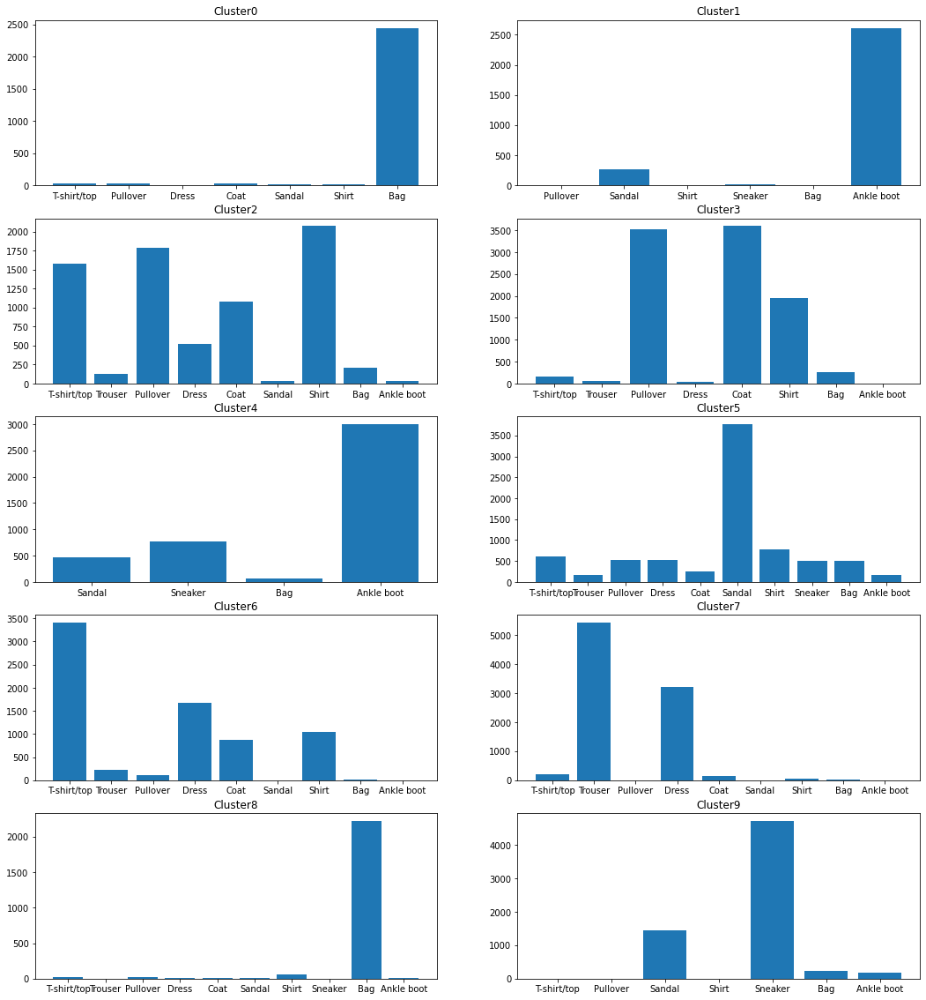

In [143]:
#Visualization of cluster points using barplots
print('Cluster Visualization without PCA')
plt.figure(figsize=(18,20))
for i in range(1,11):
    plt.subplot(5,2,i)
    label_count_=y_label_count_actual[i-1]
    plt.bar(range(len(label_count_)),list(label_count_.values()),align='center')
    plt.title('Cluster' + str(i-1))
    a=[]
    for key,value in label_count_.items():
        for key1, value1 in class_label.items():
            if key1 == key:
                a.append(value1)
                break
    plt.xticks(range(len(a)),a) 

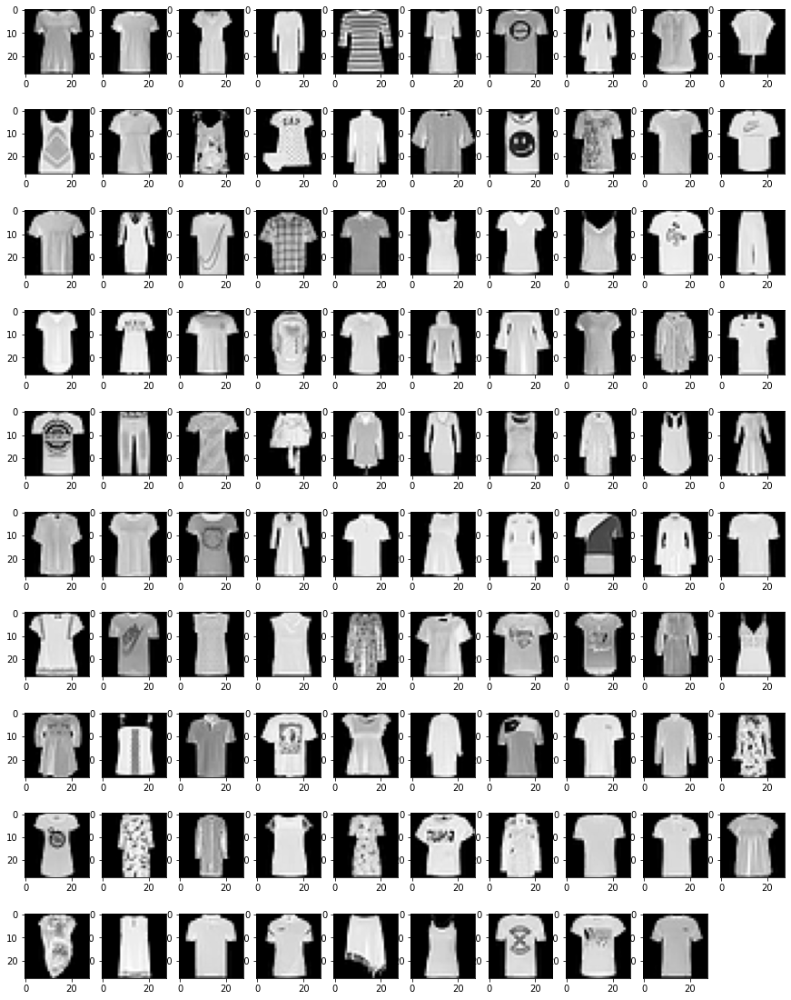

In [144]:
#visualization for clusters
plt.figure(figsize= (15,20))
cluster = 0
for i in range(1,100):
    plt.subplot(10,10,i)
    plt.imshow(x_train[cluster_indexes_pca[cluster][i]].reshape(28,28),cmap= plt.cm.gray)
plt.show()

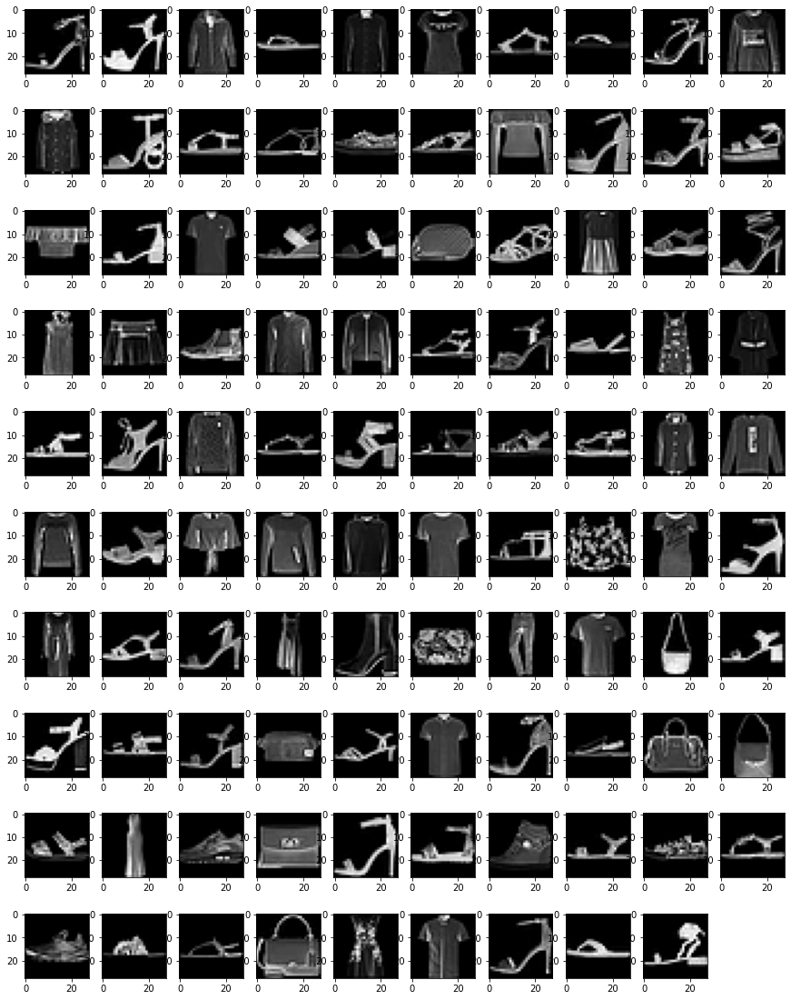

In [145]:
plt.figure(figsize= (15,20))
cluster = 2
for i in range(1,100):
    plt.subplot(10,10,i)
    plt.imshow(x_train[cluster_indexes_pca[cluster][i]].reshape(28,28),cmap= plt.cm.gray)
plt.show()

In [146]:
# define range of k between 1 to 10
k_rng = range(1,20)
sse = []
for k in k_rng:
  km = KMeans(n_clusters = k)
  km.fit(x_train_scal_pca)
  sse.append(km.inertia_)

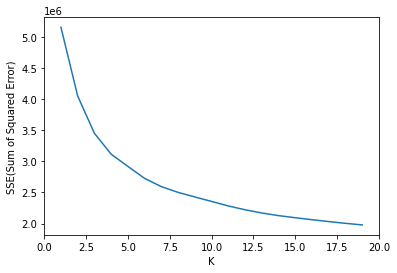

In [147]:
plt.xlabel('K')
plt.ylabel('SSE(Sum of Squared Error)')
plt.xlim(0,20)
plt.plot(k_rng,sse)

# Logistic Regreesion


# Not use of PCA

In [148]:
from sklearn.linear_model import LogisticRegression
start_time = time.time()
model = LogisticRegression()
model.fit(x_train_scal,y_train)
print("using Logistic Regression with 784 features took %s seconds" % (time.time() - start_time))

using Logistic Regression with 784 features took 28.419299840927124 seconds


In [149]:
model.score(x_test_scal,y_test)

0.8434

In [150]:
y_predict = model.predict(x_test_scal)

In [151]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [152]:
x_test_visual = pca.fit_transform(x_test_scal)
x_test_visual.shape

(10000, 3)

In [153]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [154]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [155]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 1043
No. of items in Cluster 1: 990
No. of items in Cluster 2: 1018
No. of items in Cluster 3: 1032
No. of items in Cluster 4: 1024
No. of items in Cluster 5: 991
No. of items in Cluster 6: 884
No. of items in Cluster 7: 1027
No. of items in Cluster 8: 1002
No. of items in Cluster 9: 989


In [156]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [157]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

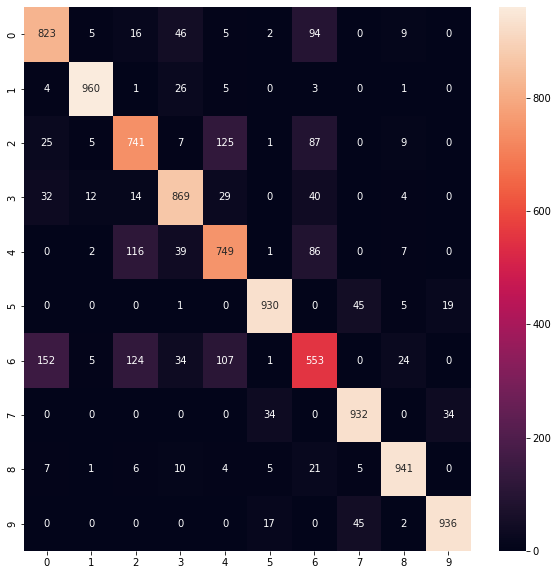

In [158]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [159]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.79      0.82      0.81      1000
           1       0.97      0.96      0.96      1000
           2       0.73      0.74      0.73      1000
           3       0.84      0.87      0.86      1000
           4       0.73      0.75      0.74      1000
           5       0.94      0.93      0.93      1000
           6       0.63      0.55      0.59      1000
           7       0.91      0.93      0.92      1000
           8       0.94      0.94      0.94      1000
           9       0.95      0.94      0.94      1000

    accuracy                           0.84     10000
   macro avg       0.84      0.84      0.84     10000
weighted avg       0.84      0.84      0.84     10000



# Use of PCA

In [160]:
from sklearn.linear_model import LogisticRegression
start_time = time.time()
model = LogisticRegression()
model.fit(x_train_scal_pca,y_train)
print("using Logistic Regression with 420 features took %s seconds" % (time.time() - start_time))

using Logistic Regression with 420 features took 15.941658735275269 seconds


In [161]:
model.score(x_test_scal_pca,y_test)

0.8429

In [162]:
y_predict = model.predict(x_test_scal_pca)

In [163]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [164]:
x_test_visual = pca.fit_transform(x_test_scal)
x_test_visual.shape

(10000, 3)

In [165]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [166]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [167]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 1013
No. of items in Cluster 1: 987
No. of items in Cluster 2: 986
No. of items in Cluster 3: 1042
No. of items in Cluster 4: 1041
No. of items in Cluster 5: 976
No. of items in Cluster 6: 906
No. of items in Cluster 7: 1043
No. of items in Cluster 8: 1012
No. of items in Cluster 9: 994


In [168]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components Using Logistic Regression')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [169]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

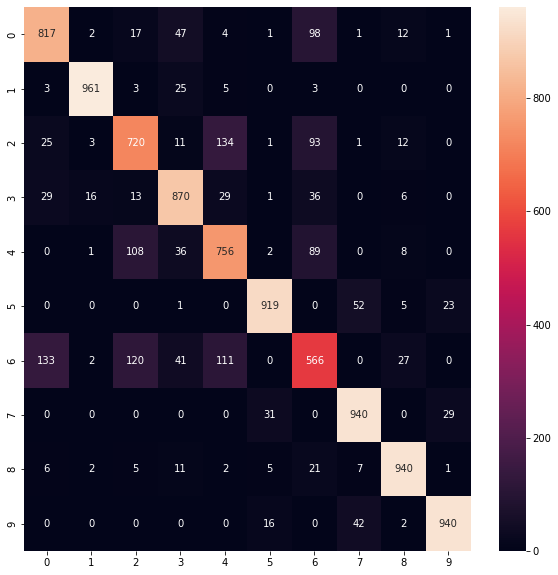

In [170]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [171]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1000
           1       0.97      0.96      0.97      1000
           2       0.73      0.72      0.73      1000
           3       0.83      0.87      0.85      1000
           4       0.73      0.76      0.74      1000
           5       0.94      0.92      0.93      1000
           6       0.62      0.57      0.59      1000
           7       0.90      0.94      0.92      1000
           8       0.93      0.94      0.93      1000
           9       0.95      0.94      0.94      1000

    accuracy                           0.84     10000
   macro avg       0.84      0.84      0.84     10000
weighted avg       0.84      0.84      0.84     10000



# SVM

# Without PCA

In [172]:
from sklearn.svm import SVC
start_time = time.time()
model = SVC(kernel='poly')
model.fit(x_train_scal,y_train)
model.score(x_test_scal,y_test)
print("using SVM with 420 features took %s seconds" % (time.time() - start_time))

using SVM with 420 features took 455.61949133872986 seconds


In [173]:
y_predict = model.predict(x_test_scal)

In [174]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [175]:
x_test_visual = pca.fit_transform(x_test_scal)
x_test_visual.shape

(10000, 3)

In [176]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [177]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [178]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 1062
No. of items in Cluster 1: 963
No. of items in Cluster 2: 965
No. of items in Cluster 3: 981
No. of items in Cluster 4: 918
No. of items in Cluster 5: 1148
No. of items in Cluster 6: 1040
No. of items in Cluster 7: 975
No. of items in Cluster 8: 973
No. of items in Cluster 9: 975


In [179]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components Using SVM Regression')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [180]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

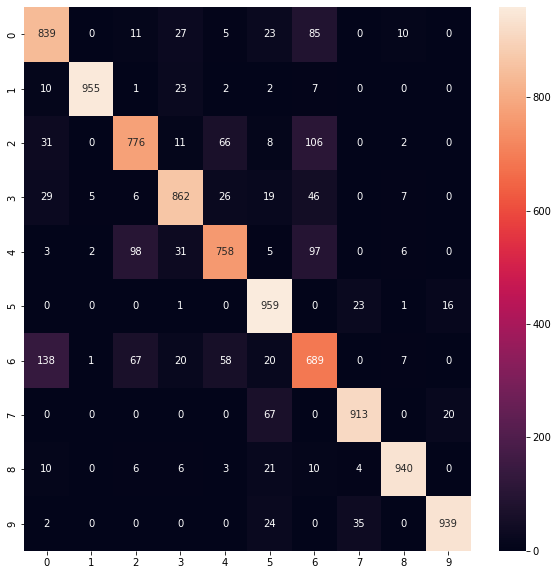

In [181]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [182]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.79      0.84      0.81      1000
           1       0.99      0.95      0.97      1000
           2       0.80      0.78      0.79      1000
           3       0.88      0.86      0.87      1000
           4       0.83      0.76      0.79      1000
           5       0.84      0.96      0.89      1000
           6       0.66      0.69      0.68      1000
           7       0.94      0.91      0.92      1000
           8       0.97      0.94      0.95      1000
           9       0.96      0.94      0.95      1000

    accuracy                           0.86     10000
   macro avg       0.87      0.86      0.86     10000
weighted avg       0.87      0.86      0.86     10000



# With PCA

In [183]:
from sklearn.svm import SVC
start_time = time.time()
model = SVC(kernel='poly')
model.fit(x_train_scal_pca,y_train)
print("using SVM with 420 features took %s seconds" % (time.time() - start_time))

using SVM with 420 features took 229.69860410690308 seconds


In [184]:
model.score(x_test_scal_pca,y_test)

0.8796

In [185]:
y_predict = model.predict(x_test_scal_pca)

In [186]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [187]:
x_test_visual = pca.fit_transform(x_test_scal_pca)
x_test_visual.shape

(10000, 3)

In [188]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [189]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [190]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 995
No. of items in Cluster 1: 964
No. of items in Cluster 2: 992
No. of items in Cluster 3: 993
No. of items in Cluster 4: 973
No. of items in Cluster 5: 974
No. of items in Cluster 6: 1092
No. of items in Cluster 7: 1029
No. of items in Cluster 8: 991
No. of items in Cluster 9: 997


In [191]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components Using Logistic Regression')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [192]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

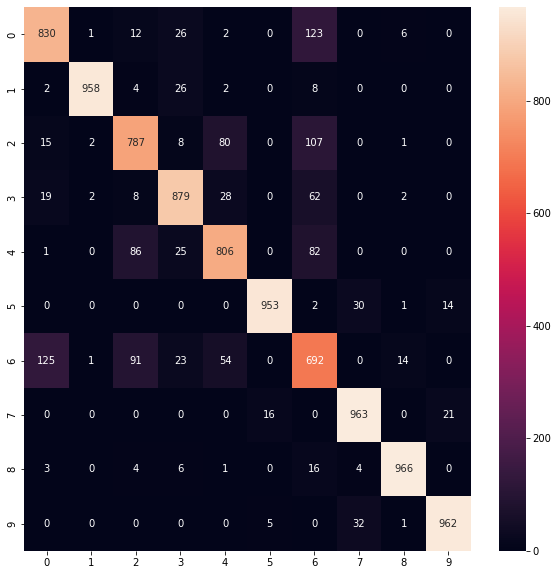

In [193]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [194]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1000
           1       0.99      0.96      0.98      1000
           2       0.79      0.79      0.79      1000
           3       0.89      0.88      0.88      1000
           4       0.83      0.81      0.82      1000
           5       0.98      0.95      0.97      1000
           6       0.63      0.69      0.66      1000
           7       0.94      0.96      0.95      1000
           8       0.97      0.97      0.97      1000
           9       0.96      0.96      0.96      1000

    accuracy                           0.88     10000
   macro avg       0.88      0.88      0.88     10000
weighted avg       0.88      0.88      0.88     10000



# Decision Tree

# Without PCA

In [195]:
from sklearn import tree
start_time = time.time()
model = tree.DecisionTreeClassifier()
model.fit(x_train_scal,y_train)
print("using Decision Tree with 784 features took %s seconds" % (time.time() - start_time))

using Decision Tree with 784 features took 48.92699599266052 seconds


In [196]:
model.score(x_test_scal,y_test)

0.7921

In [197]:
y_predict = model.predict(x_test_scal)

In [198]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [199]:
x_test_visual = pca.fit_transform(x_test_scal)
x_test_visual.shape

(10000, 3)

In [200]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [201]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [202]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 984
No. of items in Cluster 1: 997
No. of items in Cluster 2: 1038
No. of items in Cluster 3: 964
No. of items in Cluster 4: 979
No. of items in Cluster 5: 967
No. of items in Cluster 6: 1026
No. of items in Cluster 7: 1029
No. of items in Cluster 8: 1014
No. of items in Cluster 9: 1002


In [203]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components Using Logistic Regression')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [204]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

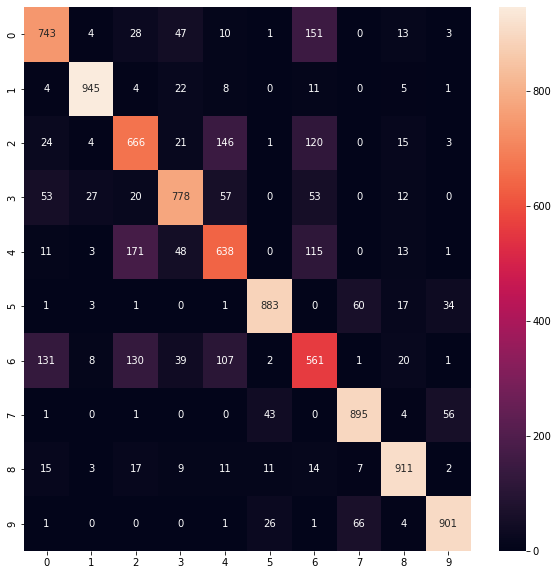

In [205]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [206]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.76      0.74      0.75      1000
           1       0.95      0.94      0.95      1000
           2       0.64      0.67      0.65      1000
           3       0.81      0.78      0.79      1000
           4       0.65      0.64      0.64      1000
           5       0.91      0.88      0.90      1000
           6       0.55      0.56      0.55      1000
           7       0.87      0.90      0.88      1000
           8       0.90      0.91      0.90      1000
           9       0.90      0.90      0.90      1000

    accuracy                           0.79     10000
   macro avg       0.79      0.79      0.79     10000
weighted avg       0.79      0.79      0.79     10000



# With PCA

In [207]:
from sklearn import tree
start_time = time.time()
model = tree.DecisionTreeClassifier()
model.fit(x_train_scal_pca,y_train)
print("using Decision Tree with 784 features took %s seconds" % (time.time() - start_time))

using Decision Tree with 784 features took 74.96454763412476 seconds


In [208]:
model.score(x_test_scal_pca,y_test)

0.7517

In [209]:
y_predict = model.predict(x_test_scal_pca)

In [210]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [211]:
x_test_visual = pca.fit_transform(x_test_scal_pca)
x_test_visual.shape

(10000, 3)

In [212]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [213]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [214]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 966
No. of items in Cluster 1: 996
No. of items in Cluster 2: 1022
No. of items in Cluster 3: 980
No. of items in Cluster 4: 1003
No. of items in Cluster 5: 983
No. of items in Cluster 6: 1040
No. of items in Cluster 7: 1016
No. of items in Cluster 8: 984
No. of items in Cluster 9: 1010


In [215]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components Using Logistic Regression')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [216]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

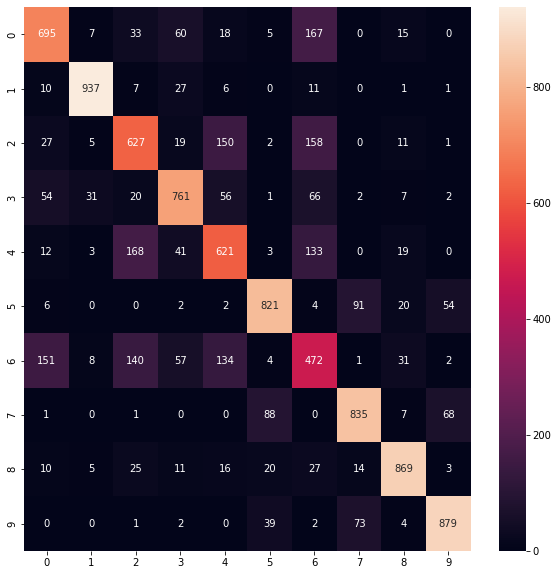

In [217]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [218]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.72      0.69      0.71      1000
           1       0.94      0.94      0.94      1000
           2       0.61      0.63      0.62      1000
           3       0.78      0.76      0.77      1000
           4       0.62      0.62      0.62      1000
           5       0.84      0.82      0.83      1000
           6       0.45      0.47      0.46      1000
           7       0.82      0.83      0.83      1000
           8       0.88      0.87      0.88      1000
           9       0.87      0.88      0.87      1000

    accuracy                           0.75     10000
   macro avg       0.75      0.75      0.75     10000
weighted avg       0.75      0.75      0.75     10000



# Random Forest

# Without PCA

In [219]:
from sklearn.ensemble import RandomForestClassifier
start_time = time.time()
model = RandomForestClassifier(n_estimators=20)
model.fit(x_train_scal,y_train)
print("using Random Forest with 784 features took %s seconds" % (time.time() - start_time))

using Random Forest with 784 features took 22.877617835998535 seconds


In [220]:
model.score(x_test_scal,y_test)

0.8662

In [221]:
y_predict = model.predict(x_test_scal)

In [222]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [223]:
x_test_visual = pca.fit_transform(x_test_scal)
x_test_visual.shape

(10000, 3)

In [224]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [225]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [226]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 1051
No. of items in Cluster 1: 969
No. of items in Cluster 2: 1103
No. of items in Cluster 3: 1036
No. of items in Cluster 4: 1021
No. of items in Cluster 5: 975
No. of items in Cluster 6: 806
No. of items in Cluster 7: 1032
No. of items in Cluster 8: 1012
No. of items in Cluster 9: 995


In [227]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components Using Logistic Regression')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [228]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

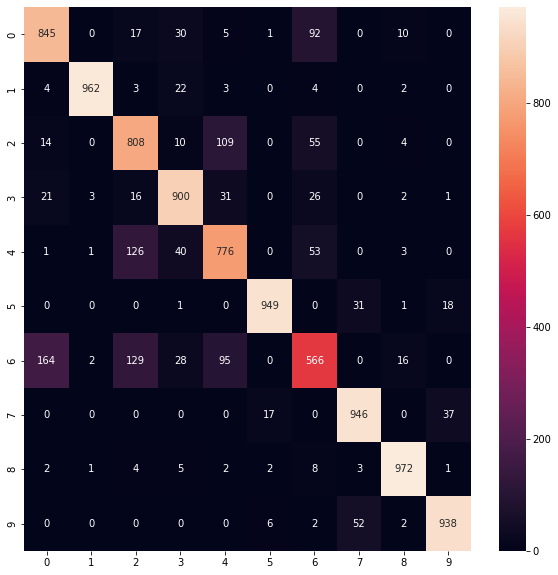

In [229]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [230]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.80      0.84      0.82      1000
           1       0.99      0.96      0.98      1000
           2       0.73      0.81      0.77      1000
           3       0.87      0.90      0.88      1000
           4       0.76      0.78      0.77      1000
           5       0.97      0.95      0.96      1000
           6       0.70      0.57      0.63      1000
           7       0.92      0.95      0.93      1000
           8       0.96      0.97      0.97      1000
           9       0.94      0.94      0.94      1000

    accuracy                           0.87     10000
   macro avg       0.87      0.87      0.86     10000
weighted avg       0.87      0.87      0.86     10000



# With PCA

In [231]:
from sklearn.ensemble import RandomForestClassifier
start_time = time.time()
model = RandomForestClassifier(n_estimators=20)
model.fit(x_train_scal_pca,y_train)
print("using Random Forest with 420 features took %s seconds" % (time.time() - start_time))

using Random Forest with 420 features took 35.65325212478638 seconds


In [232]:
model.score(x_test_scal_pca,y_test)

0.823

In [233]:
y_predict = model.predict(x_test_scal_pca)

In [234]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)

In [235]:
x_test_visual = pca.fit_transform(x_test_scal_pca)
x_test_visual.shape

(10000, 3)

In [236]:
num_cluster_labels = len(np.unique(y_predicted_actual))
#assigning indexes into respective cluster members
cluster_indexes_actual = [[] for i in range(num_cluster_labels_actual)]

In [237]:
#print(cluster_indexes)
for i,label in enumerate(y_predict):
    for n in range(num_cluster_labels):
        if label == n:
            cluster_indexes_actual[n].append(i)
        else:
            continue

In [238]:
#number of datapoints in individual clusters
print('Without PCA')
for i in range(num_cluster_labels):
    print('No. of items in Cluster ' + str(i) + ': ' + str(len(cluster_indexes_actual[i])))

Without PCA
No. of items in Cluster 0: 1133
No. of items in Cluster 1: 957
No. of items in Cluster 2: 1098
No. of items in Cluster 3: 1008
No. of items in Cluster 4: 1012
No. of items in Cluster 5: 986
No. of items in Cluster 6: 775
No. of items in Cluster 7: 1004
No. of items in Cluster 8: 1005
No. of items in Cluster 9: 1022


In [239]:

# final_arr = scaler.fit_transform(df_train_)
# pca1= PCA(n_components=3)
# two_pc_arr = pca1.fit_transform(final_arr)
trace =[[] for i in range(0,10)]
colors = ['red','green' ,'blue','purple','magenta','yellow','cyan','maroon','teal','black']
#data_info = 'sandal'
for i in range(0,10):
    my_members = (cluster_indexes_actual[i])
    num_cluster = i
    trace[i] = go.Scatter3d(
        x=x_test_visual[my_members,0],
        y=x_test_visual[my_members,1],
        z=x_test_visual[my_members,2],
        mode='markers',
        marker = dict(size = 2,color = colors[i]),
        name ='Cluster'+str(i),
        hoverinfo = 'text',
        text = 'Cluster:' + str(num_cluster)
    )
    layout = go.Layout(title = '3D Scatter plot with 2 Principal Components Using Logistic Regression')
fig = go.Figure(data=[trace[0],trace[1],trace[2],trace[3],trace[4],trace[5],trace[6],trace[7],trace[8],trace[9]],layout=layout)
iplot(fig)

In [240]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

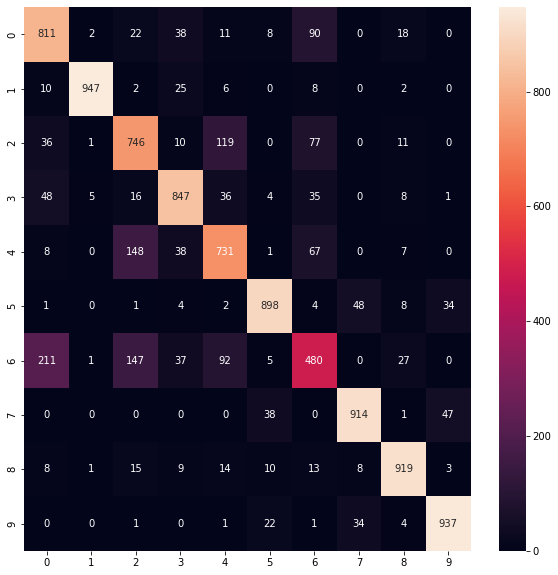

In [241]:
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(cm,annot=True,fmt='g')

In [242]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.72      0.81      0.76      1000
           1       0.99      0.95      0.97      1000
           2       0.68      0.75      0.71      1000
           3       0.84      0.85      0.84      1000
           4       0.72      0.73      0.73      1000
           5       0.91      0.90      0.90      1000
           6       0.62      0.48      0.54      1000
           7       0.91      0.91      0.91      1000
           8       0.91      0.92      0.92      1000
           9       0.92      0.94      0.93      1000

    accuracy                           0.82     10000
   macro avg       0.82      0.82      0.82     10000
weighted avg       0.82      0.82      0.82     10000



# CNN

In [243]:
import tensorflow as tf # tested with 1.14.0

In [244]:
# We begin by defining the a empty stack. We'll use this for building our 
# network, later by layer.
model = tf.keras.models.Sequential()

# We start with a convolutional layer this will extract features from 
# the input images by sliding a convolution filter over the input image, 
# resulting in a feature map.
model.add(
    tf.keras.layers.Conv2D(
        filters=32, # How many filters we will learn 
        kernel_size=(3, 3), # Size of feature map that will slide over image
        strides=(1, 1), # How the feature map "steps" across the image
        padding='valid', # We are not using padding
        activation='relu', # Rectified Linear Unit Activation Function
        input_shape=(28, 28, 1) # The expected input shape for this layer
    )
) 

# The next layer we will add is a Maxpooling layer. This will reduce the 
# dimensionality of each feature, which reduces the number of parameters that 
# the model needs to learn, which shortens training time.
model.add(
    tf.keras.layers.MaxPooling2D(
        pool_size=(2, 2), # Size feature will be mapped to
        strides=(2, 2) # How the pool "steps" across the feature
    )
)
          
# We'll now add a dropout layer. This fights overfitting and forces the model to 
# learn multiple representations of the same data by randomly disabling neurons 
# in the learning phase.
model.add(
    tf.keras.layers.Dropout(
        rate=0.25 # Randomly disable 25% of neurons
    )
)

# Output from previous layer is a 3D tensor. This must be flattened to a 1D 
# vector before beiung fed to the Dense Layers.
model.add(
    tf.keras.layers.Flatten()
)

# A dense (interconnected) layer is added for mapping the derived features 
# to the required class.
model.add(
    tf.keras.layers.Dense(
        units=128, # Output shape
        activation='relu' # Rectified Linear Unit Activation Function
    )
)

# Final layer with 10 outputs and a softmax activation. Softmax activation 
# enables me to calculate the output based on the probabilities. 
# Each class is assigned a probability and the class with the maximum 
# probability is the model’s output for the input.
model.add(
    tf.keras.layers.Dense(
        units=10, # Output shape
        activation='softmax' # Softmax Activation Function
    )
)

# Build the model
model.compile(
    loss=tf.keras.losses.sparse_categorical_crossentropy, # loss function
    optimizer=tf.keras.optimizers.Adam(), # optimizer function
    metrics=['accuracy'] # reporting metric
)

# Display a summary of the models structure
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 13, 13, 32)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 13, 13, 32)        0         
                                                                 
 flatten (Flatten)           (None, 5408)              0         
                                                                 
 dense (Dense)               (None, 128)               692352    
                                                                 
 dense_1 (Dense)             (None, 10)                1290      
                                                        

In [245]:
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=False)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.


In [246]:
x_train_scal_cnn = x_train_scal.reshape(-1,28,28,1)
x_test_scal_cnn = x_test_scal.reshape(-1,28,28,1)
x_train_scal_cnn.shape,x_test_scal_cnn.shape

((60000, 28, 28, 1), (10000, 28, 28, 1))

In [247]:
history = model.fit(
    
      # Training data : features (images) and classes.
      x_train_scal_cnn, y_train,
                    
      # number of samples to work through before updating the 
      # internal model parameters via back propagation.
      batch_size=256, 

      # An epoch is an iteration over the entire training data.
      epochs=20, 

      # The model will set apart his fraction of the training 
      # data, will not train on it, and will evaluate the loss
      # and any model metrics on this data at the end of 
      # each epoch. 
      validation_split=0.2, 

      verbose=1) 

Epoch 1/20
188/188 [==============================] - 14s 70ms/step - loss: 0.5346 - accuracy: 0.8153 - val_loss: 0.3856 - val_accuracy: 0.8643
Epoch 2/20
188/188 [==============================] - 12s 66ms/step - loss: 0.3504 - accuracy: 0.8747 - val_loss: 0.3512 - val_accuracy: 0.8737
Epoch 3/20
188/188 [==============================] - 12s 65ms/step - loss: 0.3077 - accuracy: 0.8907 - val_loss: 0.2988 - val_accuracy: 0.8919
Epoch 4/20
188/188 [==============================] - 12s 65ms/step - loss: 0.2826 - accuracy: 0.8985 - val_loss: 0.2804 - val_accuracy: 0.9007
Epoch 5/20
188/188 [==============================] - 12s 66ms/step - loss: 0.2603 - accuracy: 0.9072 - val_loss: 0.2694 - val_accuracy: 0.9041
Epoch 6/20
188/188 [==============================] - 12s 64ms/step - loss: 0.2479 - accuracy: 0.9095 - val_loss: 0.2687 - val_accuracy: 0.9033
Epoch 7/20
188/188 [==============================] - 12s 64ms/step - loss: 0.2323 - accuracy: 0.9159 - val_loss: 0.2539 - val_accuracy:

In [248]:
model.evaluate(x_test_scal_cnn,y_test)

313/313 [==============================] - 1s 4ms/step - loss: 0.2694 - accuracy: 0.9089


[0.26942095160484314, 0.9089000225067139]

In [249]:
from plotly import tools

In [250]:
def create_trace(x,y,ylabel,color):
        trace = go.Scatter(
            x = x,y = y,
            name=ylabel,
            marker=dict(color=color),
            mode = "markers+lines",
            text=x
        )
        return trace

In [251]:
!pip install pydot

In [252]:
def plot_accuracy_and_loss(train_model):
    hist = train_model.history
    acc = hist['accuracy']
    val_acc = hist['val_accuracy']
    loss = hist['loss']
    val_loss = hist['val_loss']
    epochs = list(range(1,len(acc)+1))
    
    trace_ta = create_trace(epochs,acc,"Training accuracy", "Green")
    trace_va = create_trace(epochs,val_acc,"Validation accuracy", "Red")
    trace_tl = create_trace(epochs,loss,"Training loss", "Blue")
    trace_vl = create_trace(epochs,val_loss,"Validation loss", "Magenta")
   
    fig = tools.make_subplots(rows=1,cols=2, subplot_titles=('Training and validation accuracy',
                                                             'Training and validation loss'))
    fig.append_trace(trace_ta,1,1)
    fig.append_trace(trace_va,1,1)
    fig.append_trace(trace_tl,1,2)
    fig.append_trace(trace_vl,1,2)
    fig['layout']['xaxis'].update(title = 'Epoch')
    fig['layout']['xaxis2'].update(title = 'Epoch')
    fig['layout']['yaxis'].update(title = 'Accuracy', range=[0,1])
    fig['layout']['yaxis2'].update(title = 'Loss', range=[0,1])

    
    iplot(fig, filename='accuracy-loss')

plot_accuracy_and_loss(history)

In [253]:
from sklearn.metrics import confusion_matrix, classification_report

y_pred = model.predict(x_test)
y_pred_classes = [np.argmax(i) for i in y_pred]

print(classification_report(y_test,y_pred_classes))

              precision    recall  f1-score   support

           0       0.92      0.79      0.85      1000
           1       0.95      0.99      0.97      1000
           2       0.88      0.77      0.82      1000
           3       0.94      0.83      0.89      1000
           4       0.70      0.94      0.80      1000
           5       0.96      0.99      0.97      1000
           6       0.72      0.69      0.70      1000
           7       0.95      0.95      0.95      1000
           8       0.95      0.98      0.97      1000
           9       0.98      0.94      0.96      1000

    accuracy                           0.89     10000
   macro avg       0.89      0.89      0.89     10000
weighted avg       0.89      0.89      0.89     10000

